**CV2022 - Week 3**

**Contents**

* [Gold standard algorithm](https://colab.research.google.com/drive/1OiMcriKNwGgS-B1B--JDp9nNIYEfkzN7#scrollTo=85SrfBJGoz5o)
* [Texture classification](https://colab.research.google.com/drive/1dT5v-Tj17qjHhN-tvqefQTrCNtvYexkR#scrollTo=fPeL_bu34ieR&line=5&uniqifier=1)

* [Image filtering and denoising](https://colab.research.google.com/drive/1OiMcriKNwGgS-B1B--JDp9nNIYEfkzN7#scrollTo=np1pOO2QvGZI&line=1&uniqifier=1)
* [Eigenvalues and eigenvectors](https://colab.research.google.com/drive/1OiMcriKNwGgS-B1B--JDp9nNIYEfkzN7#scrollTo=zhacxtBMu-VX)

**HOMEWORK**

**1bp** 1)Using the Sobel operator described and the generic convolution (week 2) operation, plot the filter response for a grayscale transformed RGB image.

<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/848abd56e0e33cf402f01183bfe1f68a93fb34a9" class="mwe-math-fallback-image-inline" aria-hidden="true" style="vertical-align: -4.005ex; width:62.451ex; height:9.176ex;" alt="{\displaystyle \mathbf {G} _{x}={\begin{bmatrix}+1&amp;0&amp;-1\\+2&amp;0&amp;-2\\+1&amp;0&amp;-1\end{bmatrix}}*\mathbf {A} \quad {\mbox{and}}\quad \mathbf {G} _{y}={\begin{bmatrix}+1&amp;+2&amp;+1\\0&amp;0&amp;0\\-1&amp;-2&amp;-1\end{bmatrix}}*\mathbf {A} }">


<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/23ae6772c5f58751fc6014b71d6adafb30a31c79" class="mwe-math-fallback-image-inline" aria-hidden="true" style="vertical-align: -1.671ex; width:18.895ex; height:4.843ex;" alt="\mathbf {G} ={\sqrt {{\mathbf {G} _{x}}^{2}+{\mathbf {G} _{y}}^{2}}}">

 Repeat it with the Prewitt kernel, defined as:

<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/89e0951634f88eb18d06923df71e89eb83e7fff3" class="mwe-math-fallback-image-inline" aria-hidden="true" style="vertical-align: -4.005ex; width:62.69ex; height:9.176ex;" alt="{\displaystyle \mathbf {G_{x}} ={\begin{bmatrix}+1&amp;0&amp;-1\\+1&amp;0&amp;-1\\+1&amp;0&amp;-1\end{bmatrix}}*\mathbf {A} \quad {\mbox{and}}\quad \mathbf {G_{y}} ={\begin{bmatrix}+1&amp;+1&amp;+1\\0&amp;0&amp;0\\-1&amp;-1&amp;-1\end{bmatrix}}*\mathbf {A} }">

<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/23ae6772c5f58751fc6014b71d6adafb30a31c79" class="mwe-math-fallback-image-inline" aria-hidden="true" style="vertical-align: -1.671ex; width:18.895ex; height:4.843ex;" alt="\mathbf {G} ={\sqrt {{\mathbf {G} _{x}}^{2}+{\mathbf {G} _{y}}^{2}}}">

**1bp** 2)Using the eigenfilter defined for the last exercise, analyze the filter response with respect to increasing the patch size. Relate the behaviour to the covariance matrix magnitude.

**2bp** 3)Using the definition for the eigenfilter defined in this exercise, replace the local patch approach by a k-nearest neighbors approach. Analyze the response of the filter and describe the difference to the response of the local patch approach. Discuss the behavior of the filter when increasing the number of neighbors.

**1bp** 4)Use the local patch eigenfilter approach as feature extractor for the SVC classifier. Compare the missclassification rate to the one produced by the same model with features defined as the Local Binary Pattern histogram.


1) **Gold Standard Algorithm**

The taks specified using a particular *scipy* minimizer to compute a projectivity transformation matrix that minimizes the reprojection error. Then, this projectivity matrix can be decomposed similarly to the procedure described in week 2.

The solution is provided as follows.

**References**

* Nelder, J.A. and Mead, R. (1965), “A simplex method for function minimization”, The Computer Journal, 7, pp. 308-313

* Wright, M.H. (1996), “Direct Search Methods: Once Scorned, Now Respectable”, in Numerical Analysis 1995, Proceedings of the 1995 Dundee Biennial Conference in Numerical Analysis, D.F. Griffiths and G.A. Watson (Eds.), Addison Wesley Longman, Harlow, UK, pp. 191-208

* https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.fmin.html

**Homework**


**1bp** 1)Using the Sobel operator described and the generic convolution (week 2) operation, plot the filter response for a grayscale transformed RGB image.

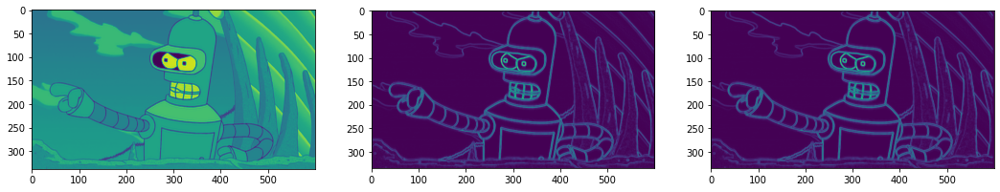

In [10]:

import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

from math import sqrt


def convol(image, kernel):
    result = np.zeros(shape = (len(image) - len(kernel), len(image[0] - len(kernel[0]))));

    for i in range(len(image) - len(kernel)):
        for j in range(len(image[0]) - len(kernel[0])):
            result[i,j] = sum([image[i + x,j + y] * kernel[x, y] for x in range(len(kernel)) for y in range(len(kernel[0]))])

    return result


def sobel(A, B):
    G = np.zeros(shape = A.shape);

    for i in range(len(A)):
        for j in range(len(B[i])):
            G[i,j] = sqrt(A[i,j]**2 + B[i,j]**2)
    
    return G


bender = cv.imread('/Users/catalin/Documents/computer-vision/Labs3/bender.png')
gray = cv.cvtColor(bender, cv.COLOR_BGR2GRAY)

K_1 = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
K_2 = K_1.T

K_P1 = np.array([[1, 0, -1], [1, 0, -1], [1, 0, -1]])
K_P2 = K_P1.T

bender_K_1 =  convol(gray, K_1)
bender_K_2 = convol(gray, K_2)

bender_K_P1 = convol(gray,K_P1);
bender_K_P2 = convol(gray, K_P2);

bender_sobel = sobel(bender_K_1, bender_K_2);
bender_sobel_p = sobel(bender_K_P1, bender_K_P2);

_, axis = plt.subplots(1, 3, figsize=(18, 6))
axis[0].imshow(gray)
axis[1].imshow(bender_sobel)
axis[2].imshow(bender_sobel_p)



**1bp** 2)Using the eigenfilter defined for the last exercise, analyze the filter response with respect to increasing the patch size. Relate the behaviour to the covariance matrix magnitude.

/var/folders/_q/98qp6zf50d17344mxw_m_6dr0000gn/T/ipykernel_17816/1742099516.py:9: RuntimeWarning: invalid value encountered in true_divide
  normalized_lp = (local_patch  - local_patch.min())/(local_patch.max() - local_patch.min())
/var/folders/_q/98qp6zf50d17344mxw_m_6dr0000gn/T/ipykernel_17816/1742099516.py:32: ComplexWarning: Casting complex values to real discards the imaginary part
  output_img[i, j, :] = agg_function(patch)


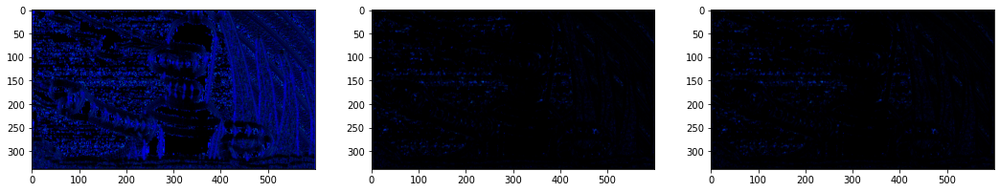

In [9]:

import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

from numpy.linalg import eig 


def top_eigenvalues(local_patch):
  normalized_lp = (local_patch  - local_patch.min())/(local_patch.max() - local_patch.min())
  covar_matrix = np.cov(normalized_lp)
  eigen_vals, eigen_vect = eig(np.nan_to_num(covar_matrix))
  return np.sort(eigen_vals)[0:3]


def eigen_filter(input_image, patch_size, agg_function):
  h, w = input_image.shape
  h_c, w_c = patch_size

  d_h = h_c // 2
  d_w = w_c // 2

  # apply zero-padding for the input image
  oper_image = np.zeros((h + 2 * d_h, w + 2 * d_w))
  oper_image[d_h:(h + d_h), d_w:(w + d_w)] = input_image
  output_img = np.zeros((h, w, 3))

  for i in range(h):
    for j in range(w):
      l_i = i + d_h
      l_j = j + d_w
      patch = oper_image[(l_i - d_h):(l_i + d_h + 1), (l_j - d_w):(l_j + d_w + 1)]
      output_img[i, j, :] = agg_function(patch)

  output_img = (output_img  - output_img.min())/(output_img.max() - output_img.min())
  return output_img


bender = cv.imread('/Users/catalin/Documents/computer-vision/Labs3/bender.png')
gray = cv.cvtColor(bender, cv.COLOR_BGR2GRAY)


# plt.imshow(eigen_filter(gray, (3, 3), top_eigenvalues))

_, axis = plt.subplots(1, 3, figsize=(18, 6))
axis[0].imshow(eigen_filter(gray, (3, 3), top_eigenvalues))
axis[1].imshow(eigen_filter(gray, (4, 4), top_eigenvalues))
axis[2].imshow(eigen_filter(gray, (5, 5), top_eigenvalues))

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np

X = [0, 0.027, 0, 0, 0.027, 0, 0.054, 0, 0, 0, 0.027, 0]
Y = [0,	0,	0.027, 0,	0,	0.027,	0, 	0.054, 0,	0, 0, 0.027]
Z = [0,	0, 0, 	0.027, 0.027,	0.027,	0,	0,	0.054,	0.081,	0.054,	0.054]

x = [866.575949367089,	783.031645569620,	930.373417721519,	862.018987341772,
     781.512658227848,	925.816455696203,	685.816455696203,	995.689873417722,	
     863.537974683544,	857.462025316456,	781.512658227848,	921.259493670886]

y = [1132.90506329114,	1135.94303797468,	1135.94303797468,	1026.57594936709,
     1023.53797468354,	1023.53797468354,	1137.46202531646,	1142.01898734177,
     917.208860759494,	821.512658227848,	915.689873417722,	912.651898734177]

# the P matrix computed with Direct Linear Transform

P = np.array([
      [-2.90472954e+03,  3.43163484e+02,  3.34242709e+02,  5.43581050e+02],
      [-1.35131680e+03, -1.34480285e+03, -1.97704973e+03,  7.11077910e+02],
      [-1.25083767e+00, -1.24480479e+00,  4.83520921e-01,  6.27638493e-01]])

# define the homogeneous coordinates for XYZ ans xy coordinate systems
XYZ_h = np.ones((4, len(X)))
XYZ_h[0, :] = np.array(X)
XYZ_h[1, :] = np.array(Y)
XYZ_h[2, :] = np.array(Z)

#same for xy
xy_h = np.ones((3, len(x)))
xy_h[0, :] = np.array(x)
xy_h[1, :] = np.array(y)

print(XYZ_h)
print(xy_h)


[[0.    0.027 0.    0.    0.027 0.    0.054 0.    0.    0.    0.027 0.   ]
 [0.    0.    0.027 0.    0.    0.027 0.    0.054 0.    0.    0.    0.027]
 [0.    0.    0.    0.027 0.027 0.027 0.    0.    0.054 0.081 0.054 0.054]
 [1.    1.    1.    1.    1.    1.    1.    1.    1.    1.    1.    1.   ]]
[[8.66575949e+02 7.83031646e+02 9.30373418e+02 8.62018987e+02
  7.81512658e+02 9.25816456e+02 6.85816456e+02 9.95689873e+02
  8.63537975e+02 8.57462025e+02 7.81512658e+02 9.21259494e+02]
 [1.13290506e+03 1.13594304e+03 1.13594304e+03 1.02657595e+03
  1.02353797e+03 1.02353797e+03 1.13746203e+03 1.14201899e+03
  9.17208861e+02 8.21512658e+02 9.15689873e+02 9.12651899e+02]
 [1.00000000e+00 1.00000000e+00 1.00000000e+00 1.00000000e+00
  1.00000000e+00 1.00000000e+00 1.00000000e+00 1.00000000e+00
  1.00000000e+00 1.00000000e+00 1.00000000e+00 1.00000000e+00]]


In [ ]:
# now let's define the reprojection error with respect to the projection matrix P
# the  P array will be the variable the minimization is done w.r.t.
# this minimizer works with python primitives or 1D arrays
def compute_reprojection_error(P, XYZ=XYZ_h, xy=xy_h):
  P = P.reshape((3, 4))
  num_pts = XYZ.shape[1]
  
  # compute the reprojections for the image points in the 3D world
  reprojected_image_points = P @ XYZ

  # they shold be in homogeneous coordinates
  for i in range(num_pts):
    reprojected_image_points[:, i] = 1/reprojected_image_points[2, i] * reprojected_image_points[:, i]
  
  img_diff = xy - reprojected_image_points
  
  reprojection_error = 0
  for i in range(num_pts):
    reprojection_error += img_diff[:, i].dot(img_diff[:, i])

  return reprojection_error

In [ ]:
# flatten the P matrix to cope with minimizer limitations
initial_error = compute_reprojection_error(P.flatten(), XYZ_h, xy_h)
print(initial_error)

199.26085321073896


In [ ]:
# now we will use the minimizer to find a better guess for the P matrix


from scipy import optimize

P_minimum  = optimize.fmin(compute_reprojection_error, x0=P)
print(P_minimum)
P_minimum = P_minimum.reshape((3, 4))

[-2.72181646e+03  4.20026388e+02  4.06676823e+02  5.45549599e+02
 -9.86749262e+02 -1.15892547e+03 -1.98398884e+03  7.12991436e+02
 -9.21399286e-01 -1.09756492e+00  5.39349926e-01  6.29171945e-01]


In the cell below we are going to reproject the points on the calibration pattern, to visually inspect the quality of the projection matrix produced.
As the *P_minimum* matrix is the minimization result, the points reprojected with this matrix should be better aligned with the ground truth dots.

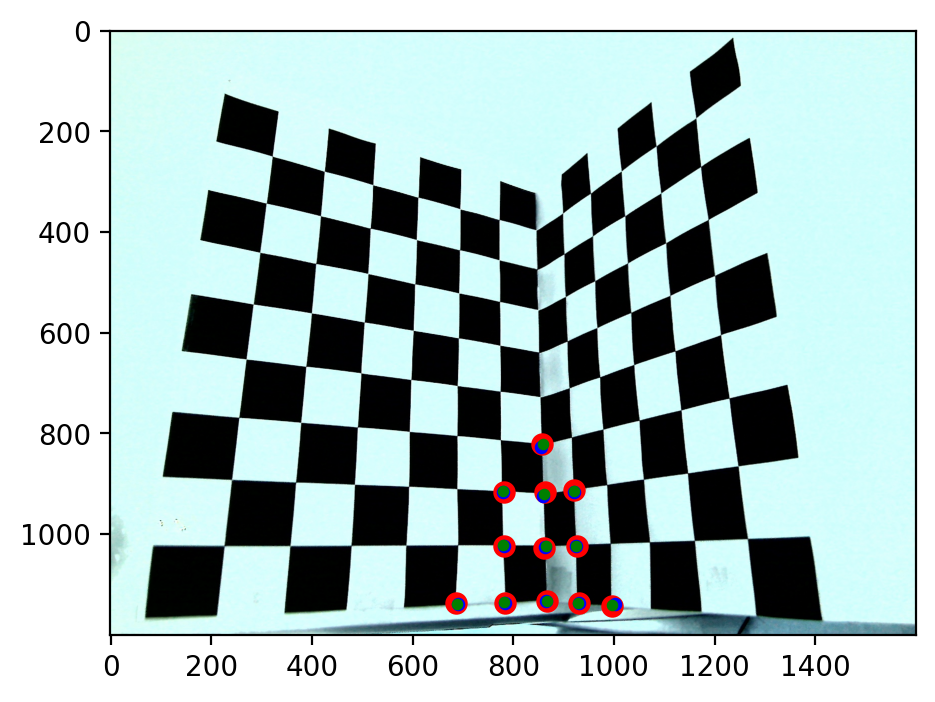

In [ ]:
import cv2 as cv
import matplotlib.pyplot as plt

# just for a bigger figure
plt.rcParams['figure.figsize'] = [8, 4]
plt.rcParams['figure.dpi'] = 200

calibration_img = cv.imread("/content/drive/MyDrive/CV2022/pics/image001.jpg")

# using the projection matrix, reproject the 3D points in the image
N = len(X)
computed_xy = P @ XYZ_h
minimized_xy = P_minimum @ XYZ_h
# make sure the result in stil in homogeneous coords.

for i in range(N):
  computed_xy[:, i] = 1/computed_xy[2, i] * computed_xy[:, i]
  minimized_xy[:, i] = 1/minimized_xy[2, i] * minimized_xy[:, i]

plt.imshow(calibration_img)
for i in range(len(x)):
  plt.scatter(x[i], y[i], s=50, c='red', marker='o')
  plt.scatter(computed_xy[0, i], computed_xy[1, i], s=15, c='blue', marker='o')
  plt.scatter(minimized_xy[0, i], minimized_xy[1, i], s=10, c='green', marker='o')




In [ ]:
minimized_error = compute_reprojection_error(P_minimum.flatten(), XYZ_h, xy_h)
print(minimized_error)

53.82803702941379


2) **Texture classification**

In this exercise we will experiment the effectiveness of the Support Vectors Machine Classifier (SVC) on extracted features consisting of the local normalized histogram.


**References**

1. [Local Binary Pattern](http://www.scholarpedia.org/article/Local_Binary_Patterns)
2. [GLCM Texture Features](https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_glcm.html#sphx-glr-auto-examples-features-detection-plot-glcm-py)
3. [Local Binary Pattern for texture classification](https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_local_binary_pattern.html#sphx-glr-auto-examples-features-detection-plot-local-binary-pattern-py)



In [ ]:
# simple function to display the results
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()

In [ ]:
import os
from imutils import paths
from skimage import feature
from sklearn.svm import LinearSVC

def describe_local_binary_patterns(image, radius, num_points, eps=1e-7):
		# compute the Local Binary Pattern representation
		# of the image, and then use the LBP representation
		# to build the histogram of patterns
		lbp = feature.local_binary_pattern(image, num_points,
			      radius, method="uniform")
  
		(hist, _) = np.histogram(lbp.ravel(),
			            bins=np.arange(0, num_points + 3),
			            range=(0, num_points + 2))
  
		# normalize the histogram
		hist = hist.astype("float")
		hist /= (hist.sum() + eps)
		# return the histogram of Local Binary Patterns
		return hist


data = []
labels = []
path = "/content/drive/MyDrive/CV2022/pics/dataset/train"

for image_path in paths.list_images(path):
	# load the image, convert it to grayscale, and describe it
	image = cv.imread(image_path)
	gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
	hist = describe_local_binary_patterns(gray, radius=8, num_points=24)
	# extract the label from the image path, then update the
	# label and data lists
	labels.append(image_path.split(os.path.sep)[-2])
	data.append(hist)
 

# train a Linear SVM on the data
model = LinearSVC(C=100.0, random_state=42)
model.fit(data, labels)


/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,


LinearSVC(C=100.0, random_state=42)

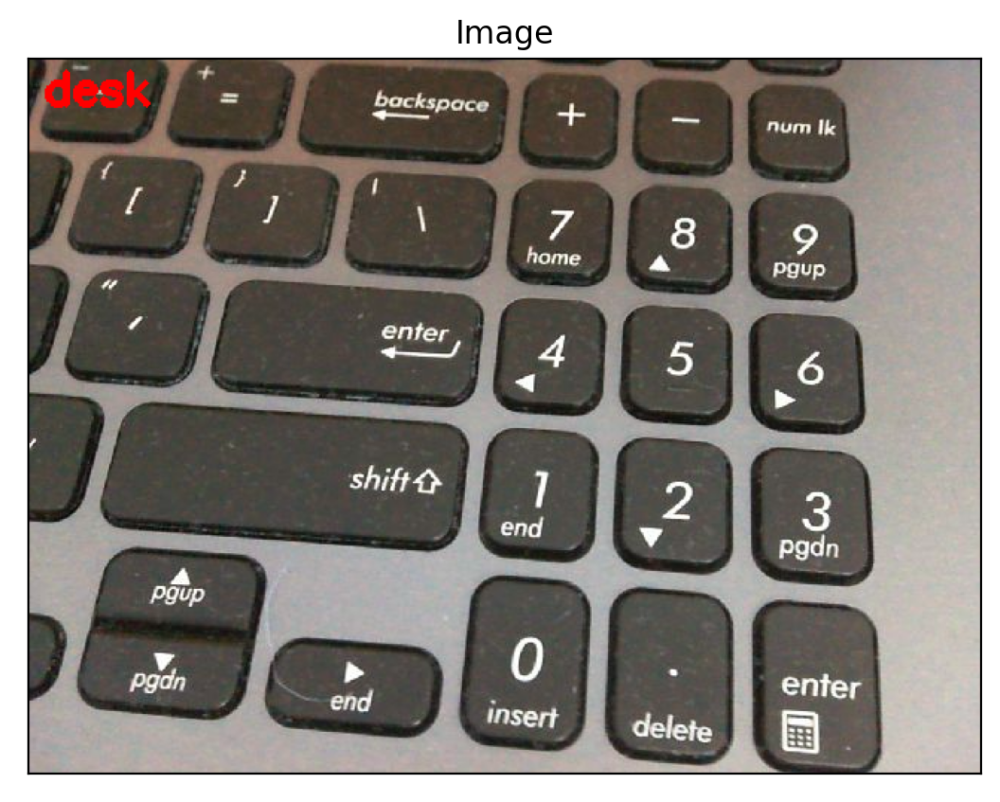

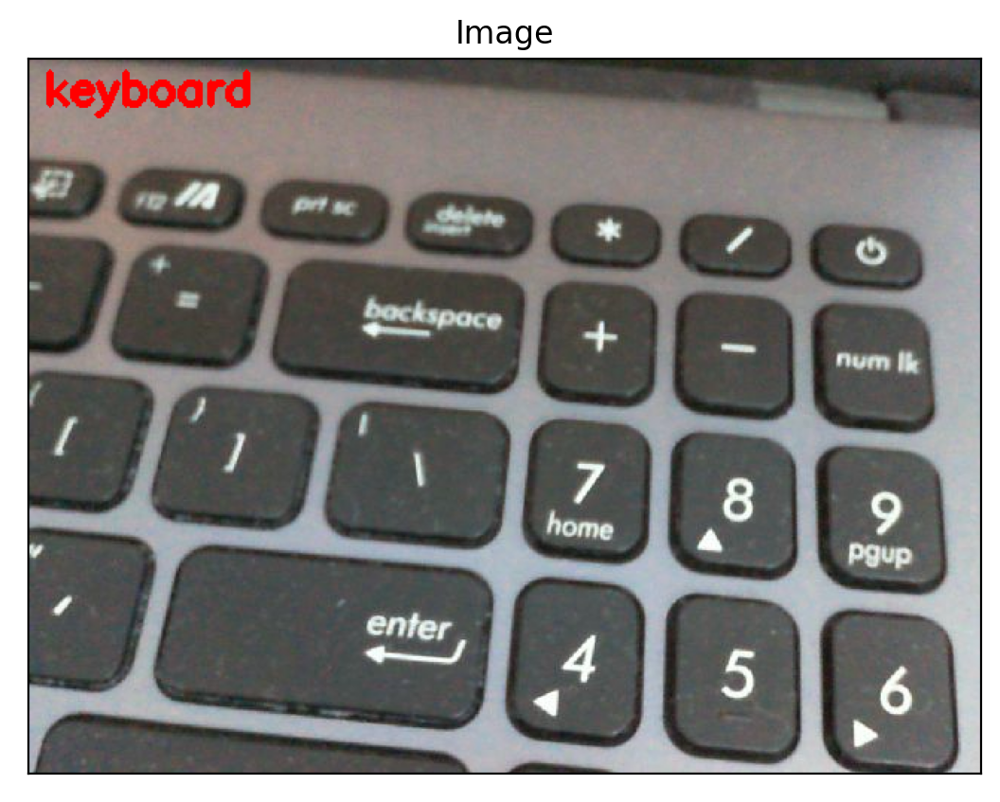

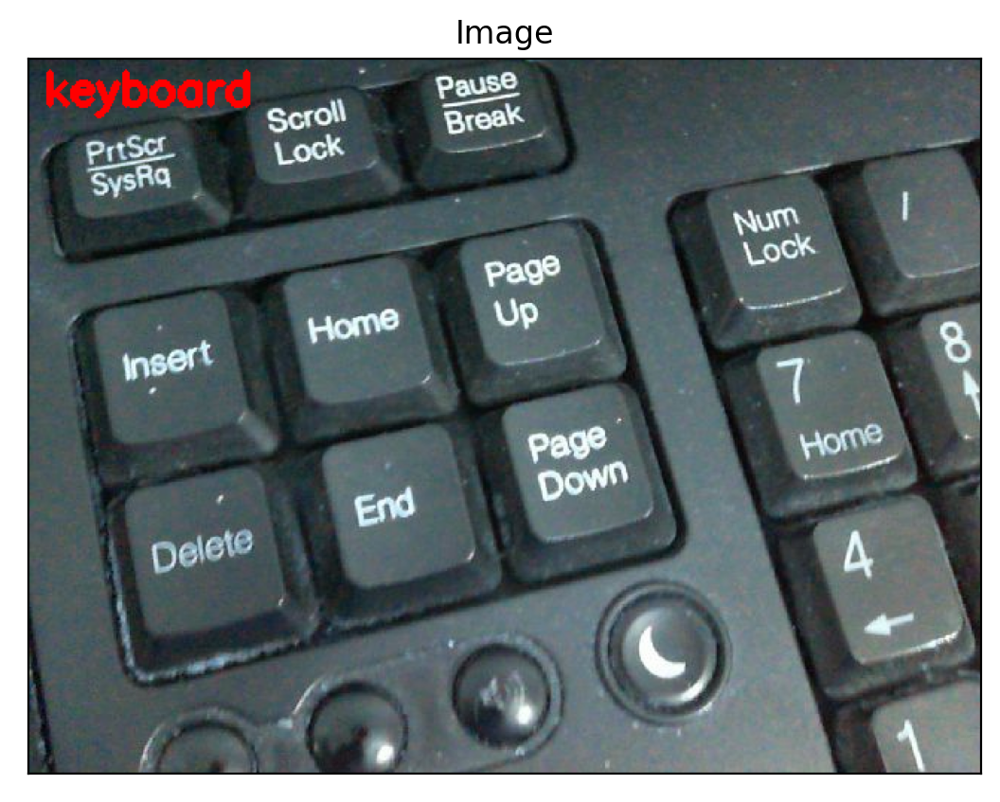

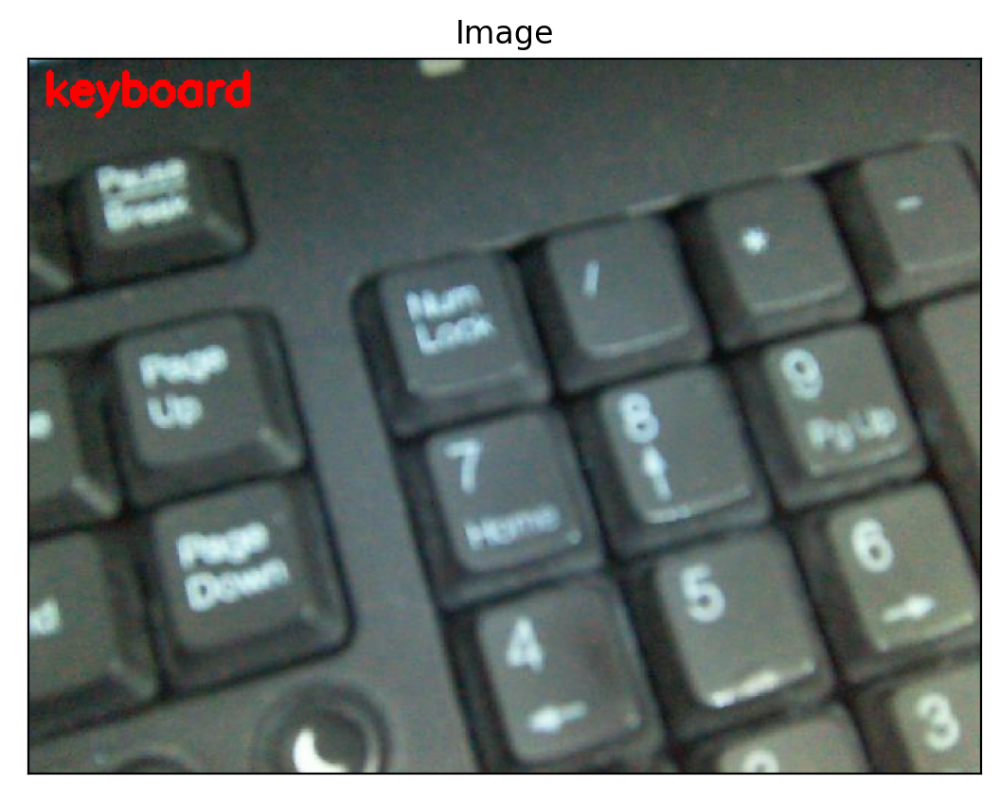

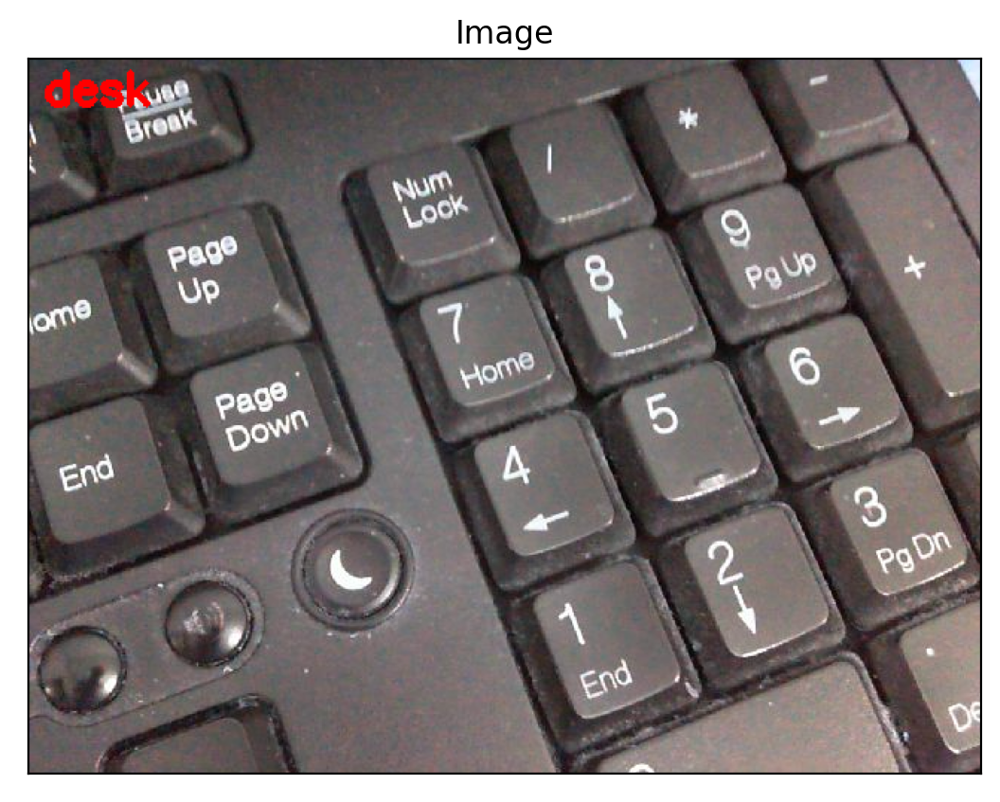

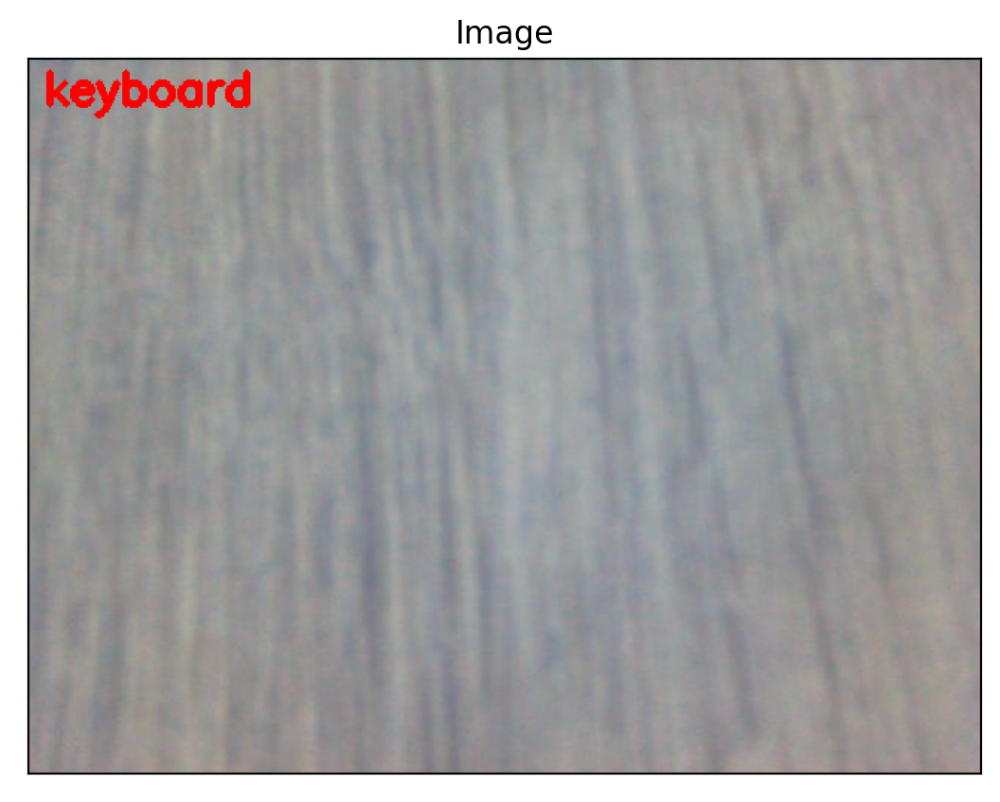

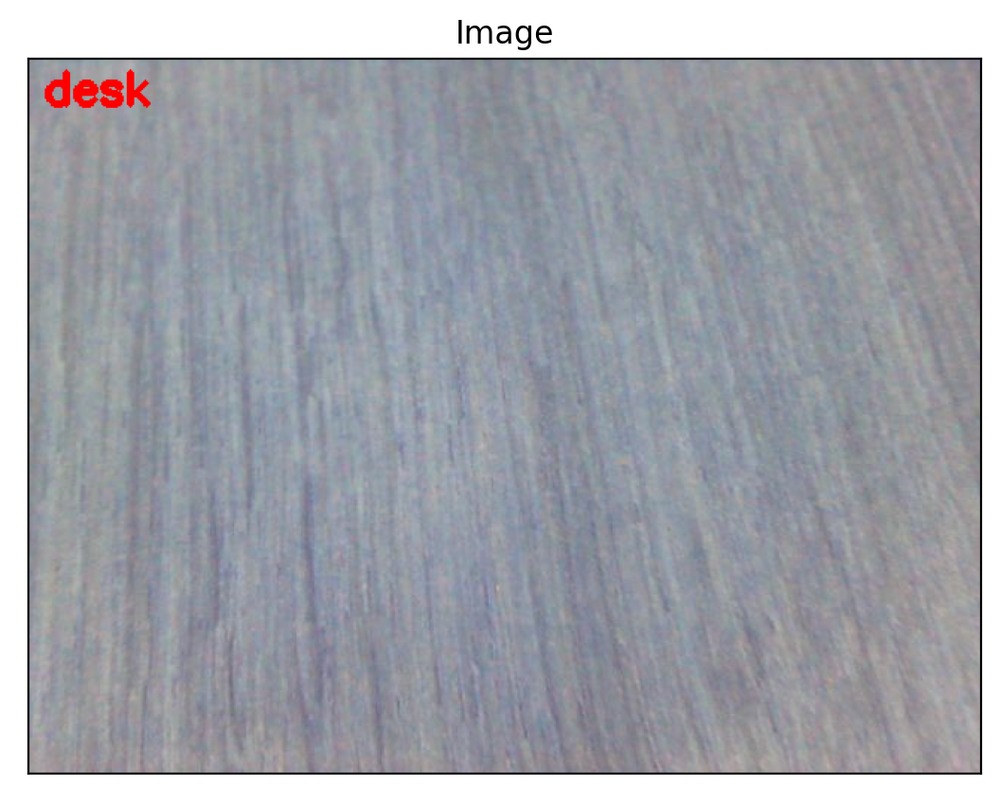

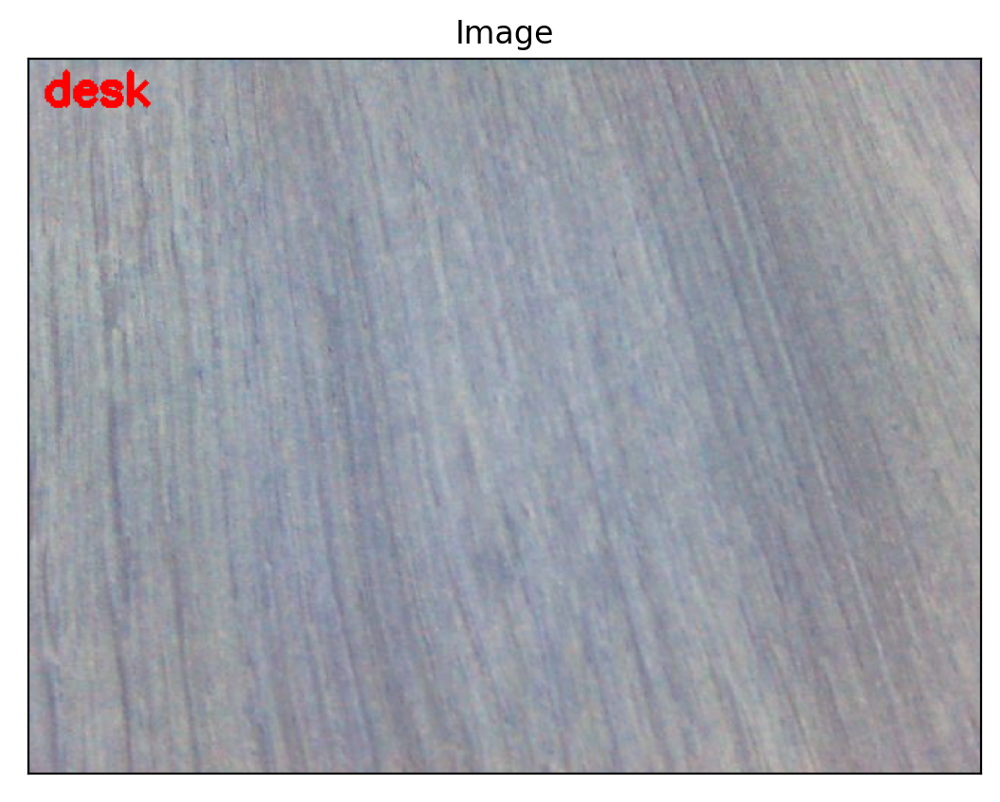

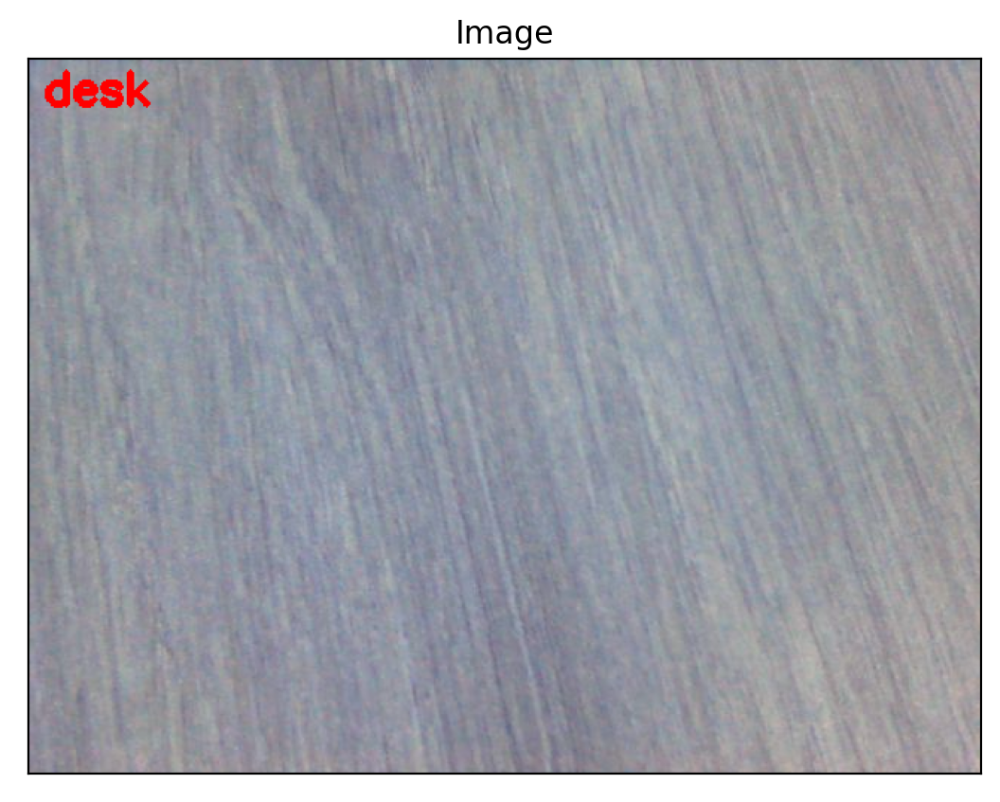

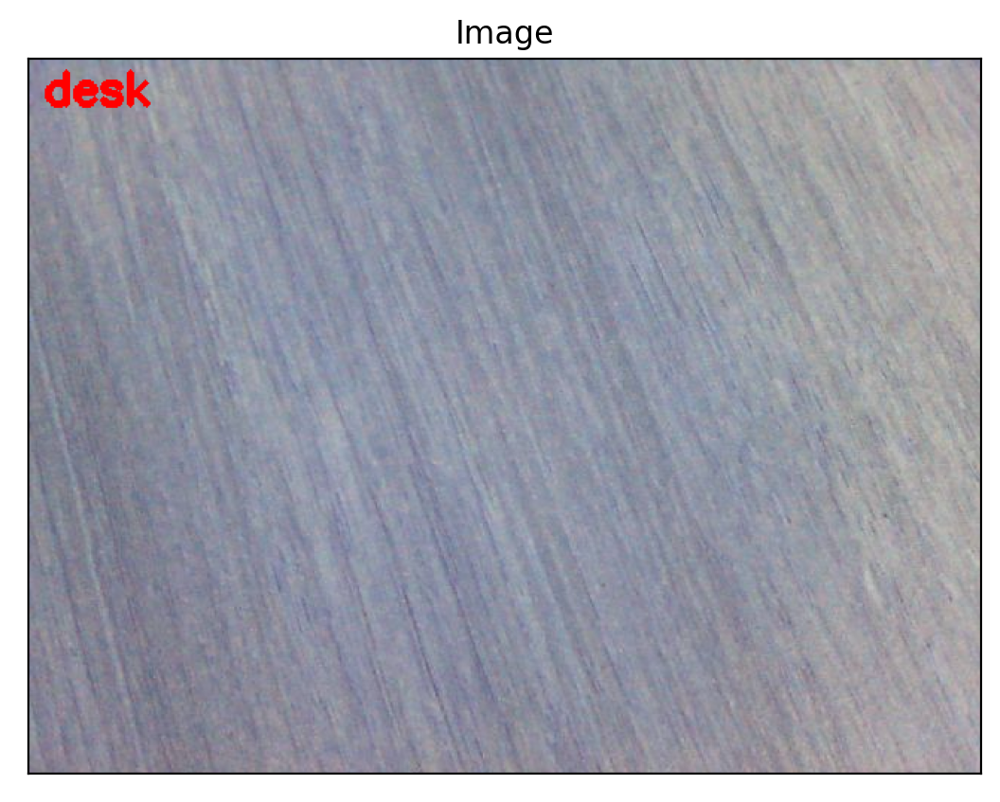

In [ ]:
# process the test data to assess the performance of the model

test_path = "/content/drive/MyDrive/CV2022/pics/dataset/test"

for image_path in paths.list_images(test_path):
  image = cv.imread(image_path)
  gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  hist = describe_local_binary_patterns(gray, radius=8, num_points=24)
  prediction = model.predict(hist.reshape(1, -1))

  # display the image and the prediction
  cv.putText(image, prediction[0], (10, 30), cv.FONT_HERSHEY_SIMPLEX, 
                1.0, (255, 0, 0), 3)
  visualize(image=image)




3) **Image filtering and enhancement**

The images acquired may be corrupted by random variations in intensity, variations in illumination, or poor contrast that must be dealt with in the early stages of vision processing.

A simple and effective method for image enhancement aimed at eliminating these undesirable characteristics is image filtering. There are several different type of filters that can be used:
- smooth image filter
- Gaussian blur image filter
- sharpen image filter

**Smooth image filter** - used to remove image artifcats by applying a filtering matrix that calculates the mean value of the pixels within the matrix. A smoothing filter that averages 9 pixel values in a 3x3 neighborhood of the input image pixel in order to create a smoothed output image.

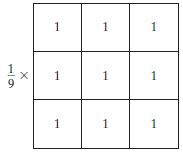


**Gaussian blur filtering**  is used to blur images and remove noise and detail.
In one dimension, the Gaussian function is:
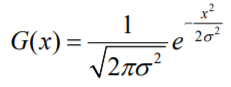

Where σ is the standard deviation of the distribution The distribution is
assumed to have a mean of 0.
Shown graphically, we see the familiar bell shaped Gaussian
distribution.

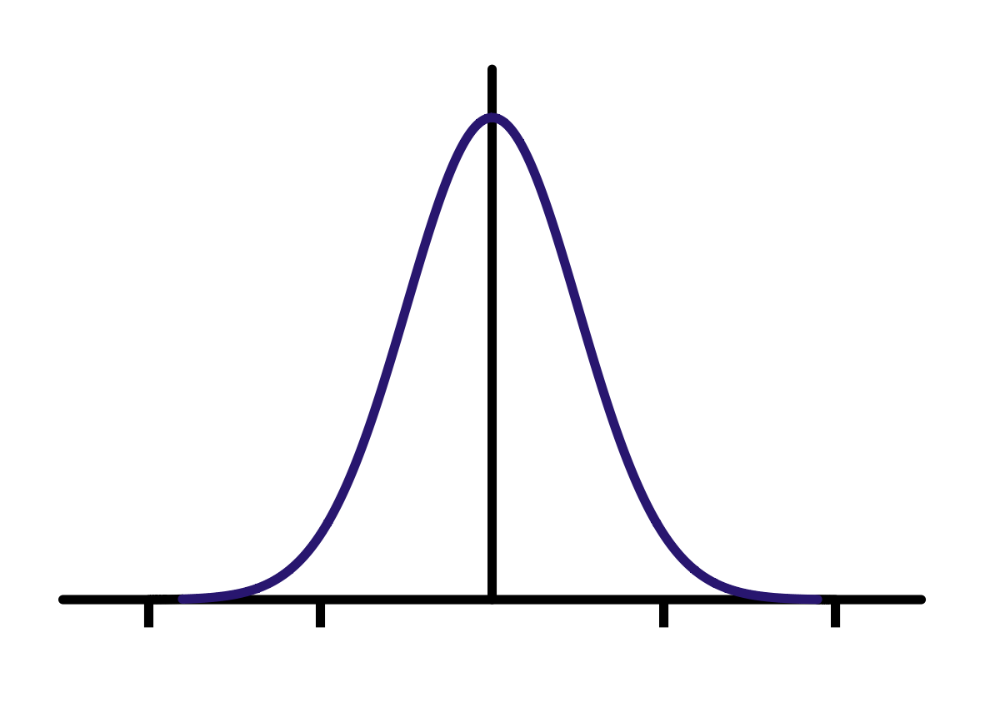

**Sharpen image filter** increases the contrast between bright and dark regions to bring out features.

The sharpening process is basically the application of a high pass filter to an image. The following array is a kernel for a common high pass filter used to sharpen an image:


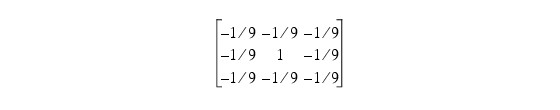


Text(0.5, 1.0, 'Sharpen')

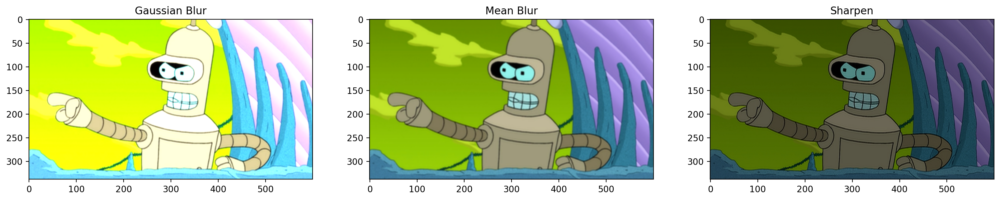

In [ ]:
img_bender = cv.imread("/content/drive/MyDrive/CV2022/pics/bender.png")

gaussian_blur_kernel = np.array(([[1, 2, 1], [2, 4, 2], [1, 2, 1]]), np.float32)/9
sharpen_kernel = np.array(([[0, -1, 0], [-1, 9, -1], [0, -1, 0]]), np.float32)/9
mean_blur_kernel = np.ones((3, 3), np.float32)/9


gaussian_blur = cv.filter2D(src=img_bender, kernel=gaussian_blur_kernel, ddepth=-1)
mean_blur = cv.filter2D(src=img_bender, kernel=mean_blur_kernel, ddepth=-1)
sharpen = cv.filter2D(src=img_bender, kernel=sharpen_kernel, ddepth=-1)

fig, axs = plt.subplots(1, 3,figsize=(20, 20))
axs[0].imshow(gaussian_blur)
axs[0].set_title('Gaussian Blur')
axs[1].imshow(mean_blur)
axs[1].set_title('Mean Blur')
axs[2].imshow(sharpen)
axs[2].set_title('Sharpen')


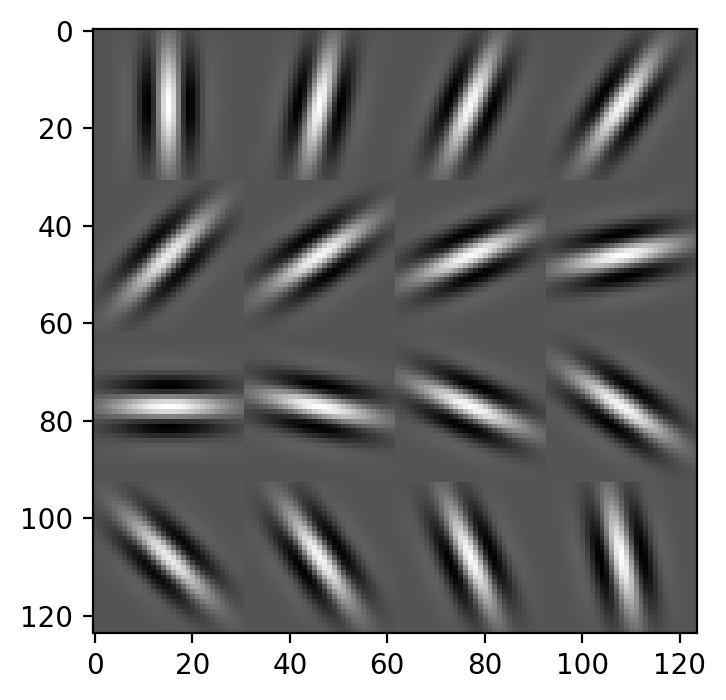

In [ ]:
img_monkey = cv.imread("/content/drive/MyDrive/CV2022/pics/monkey.png")

kernel_size = 31
thetas = [i * np.pi / 16 for i in range(16)]
filters = []

for theta in thetas:
  kernel = cv.getGaborKernel(ksize=(kernel_size, kernel_size), sigma=4, 
                             theta=theta, lambd=10, gamma=0.5, 
                             psi=0, ktype=cv.CV_32F)
  kernel = kernel / (1.5 * kernel.sum())
  filters.append(kernel)

filter_matrix = np.zeros((4 * kernel_size, 4 * kernel_size))
for i in range(4):
  for j in range(4):
    li = (i * kernel_size)
    ri = (i + 1) * kernel_size
    lj = (j * kernel_size)
    rj = (j + 1) * kernel_size
    filter_matrix[li: ri, lj: rj] = filters[4 * i + j]

plt.imshow(filter_matrix, cmap='gray')



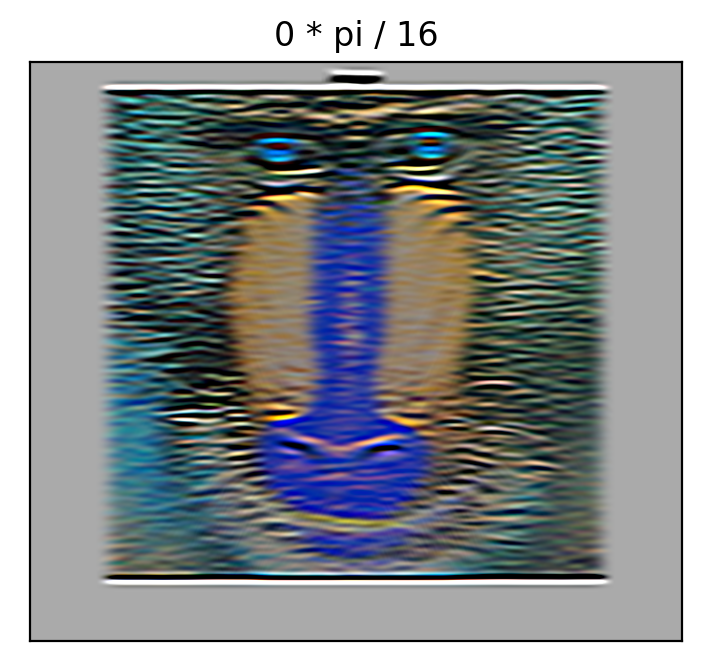

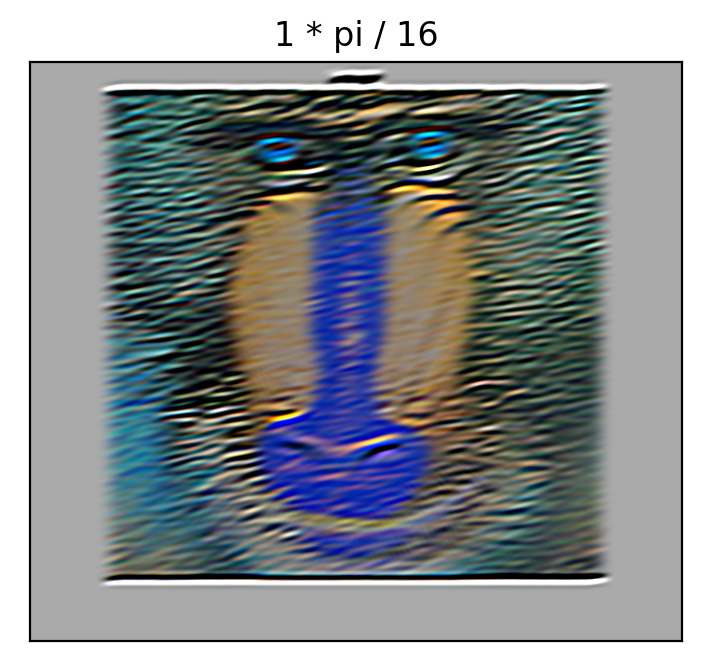

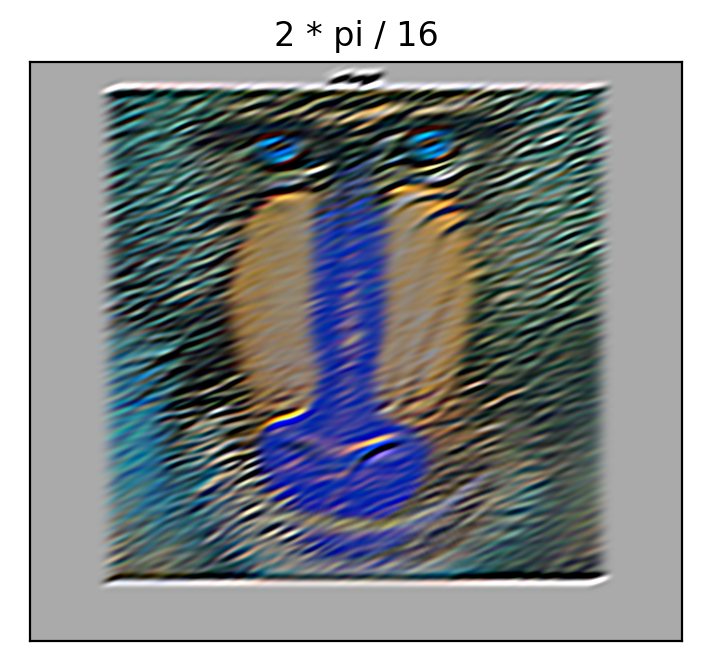

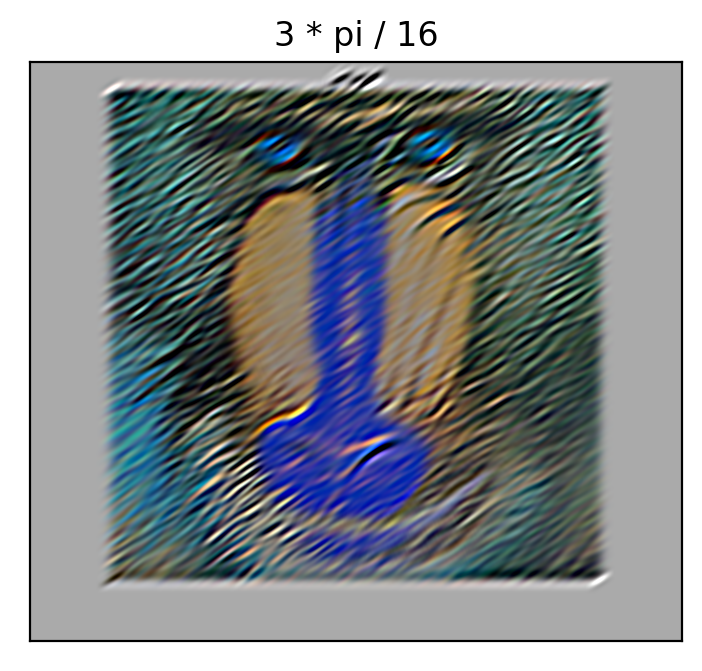

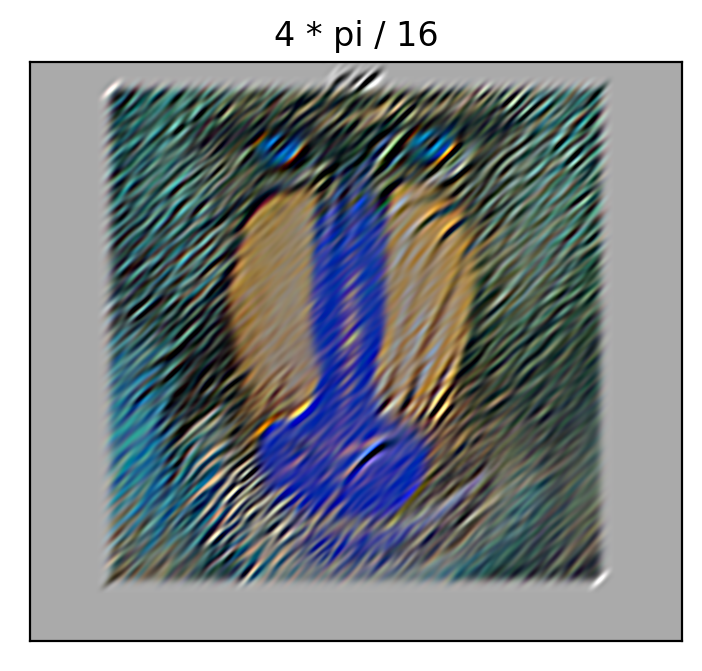

...

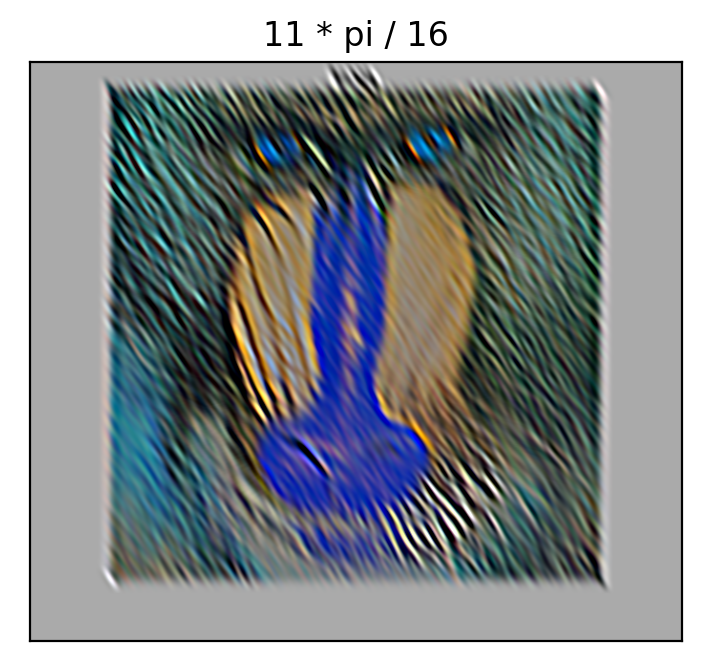

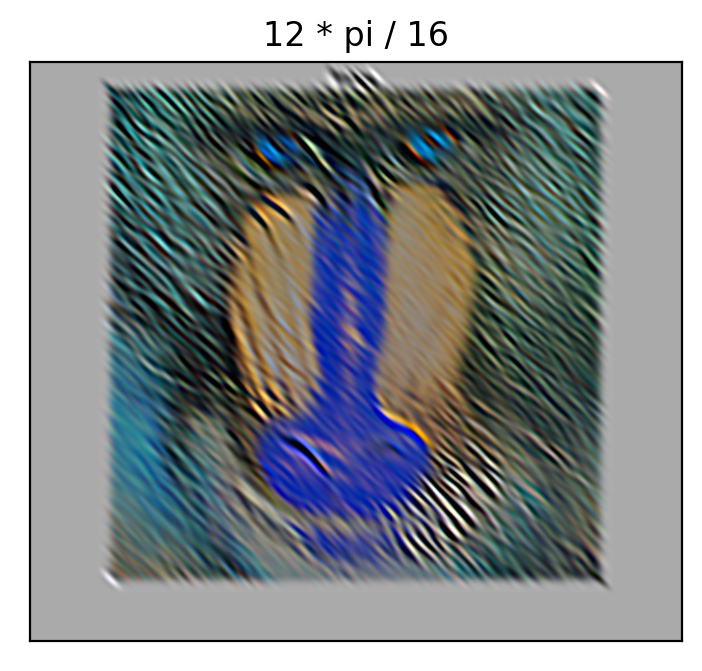

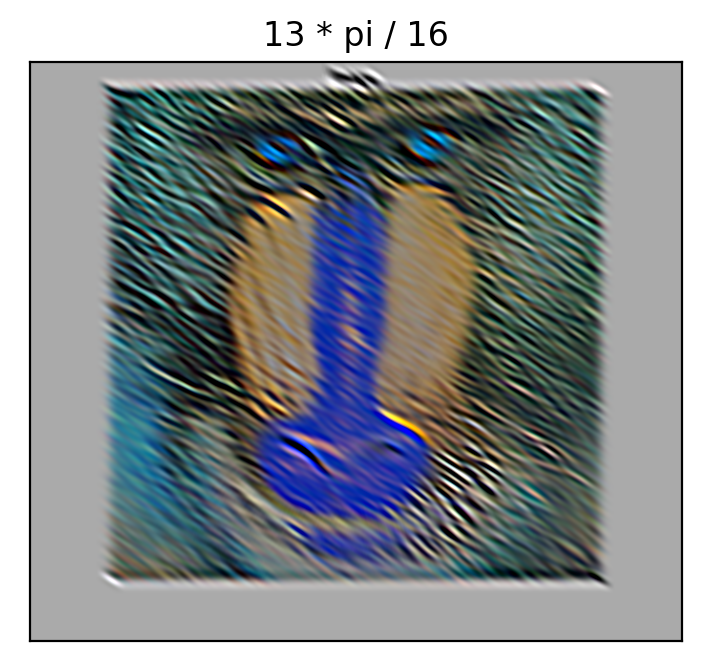

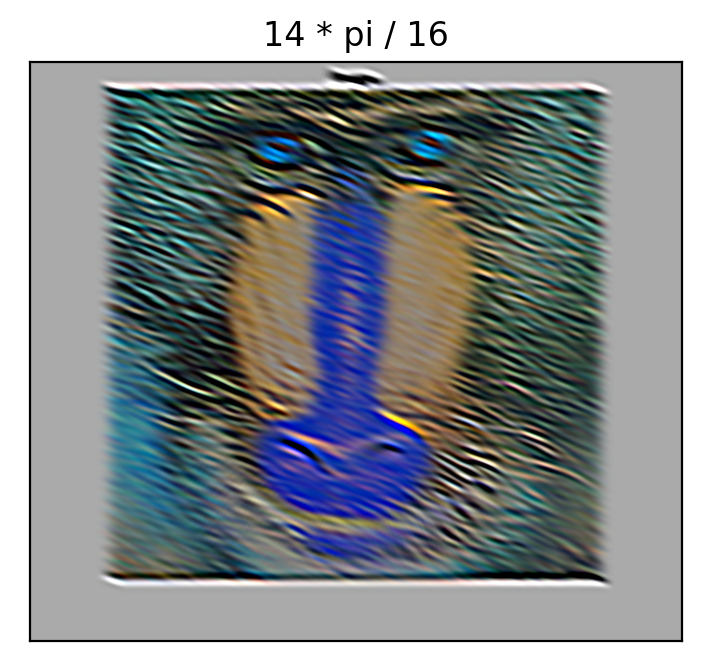

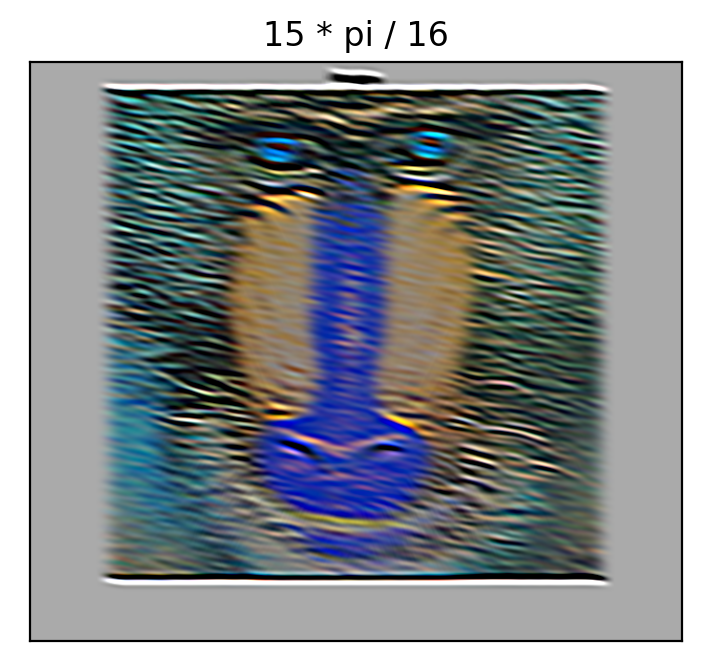

In [ ]:
result = np.zeros(img_monkey.shape)
n = len(filters)
for i, filter in enumerate(filters):
  plt.figure(figsize=(80, 50))
  filtered_img = cv.filter2D(img_monkey, -1,  filter.T)
  result = np.maximum(result, filtered_img)
  plt.subplot(1, n, i + 1)
  plt.xticks([])
  plt.yticks([])
  plt.title("{} * pi / 16".format(i))
  plt.imshow(filtered_img)
  plt.show()

  

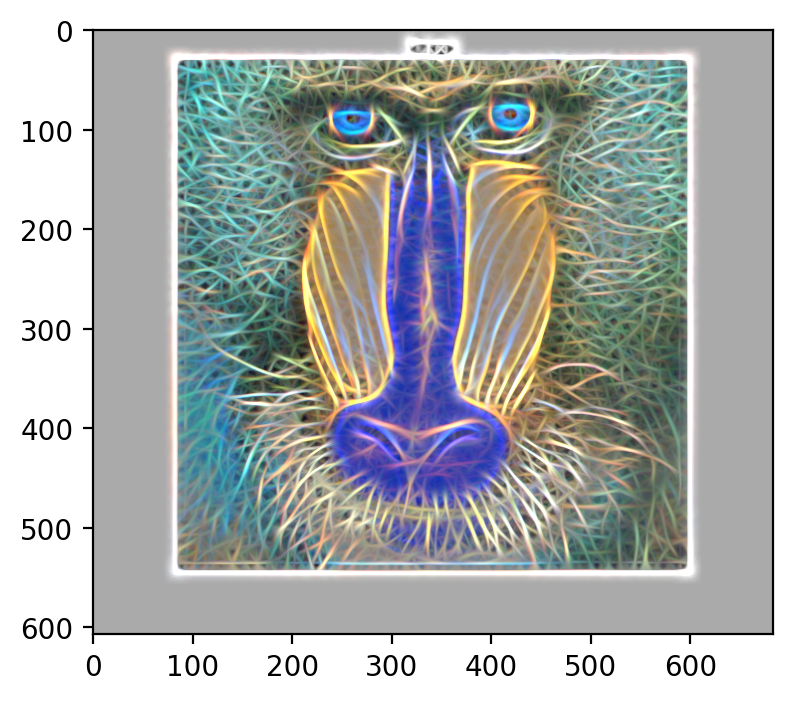

In [ ]:
result = result + result.min() / result.max()
plt.imshow(result.astype(int))

4) **Eigenfilter**

In this exercise, the solution for one particular type of filter is going to be provided. For a 1-channel image, the value of the filter output will be a 1x3 array with the three largest eigenvalues as values. The eigenvalues are going to be computed for the covariance matrix of the input values in the k x k centered neighborhood. Then, the response of the filter will be analyzed, with respect to the input image.

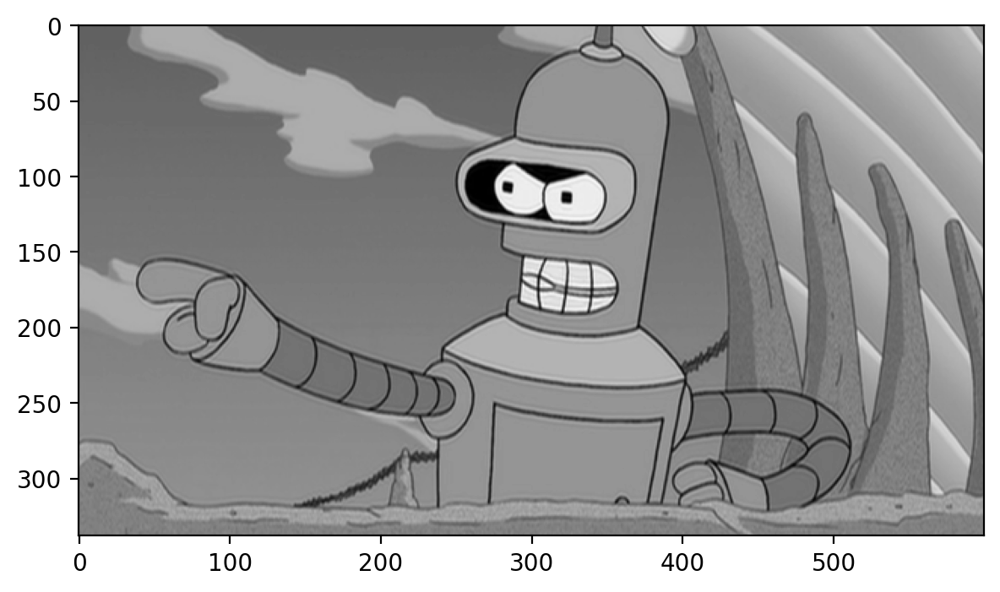

In [ ]:
bender_img_gray = cv.cvtColor(img_bender, cv.COLOR_BGR2GRAY)
plt.imshow(bender_img_gray, cmap="gray")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: ComplexWarning: Casting complex values to real discards the imaginary part


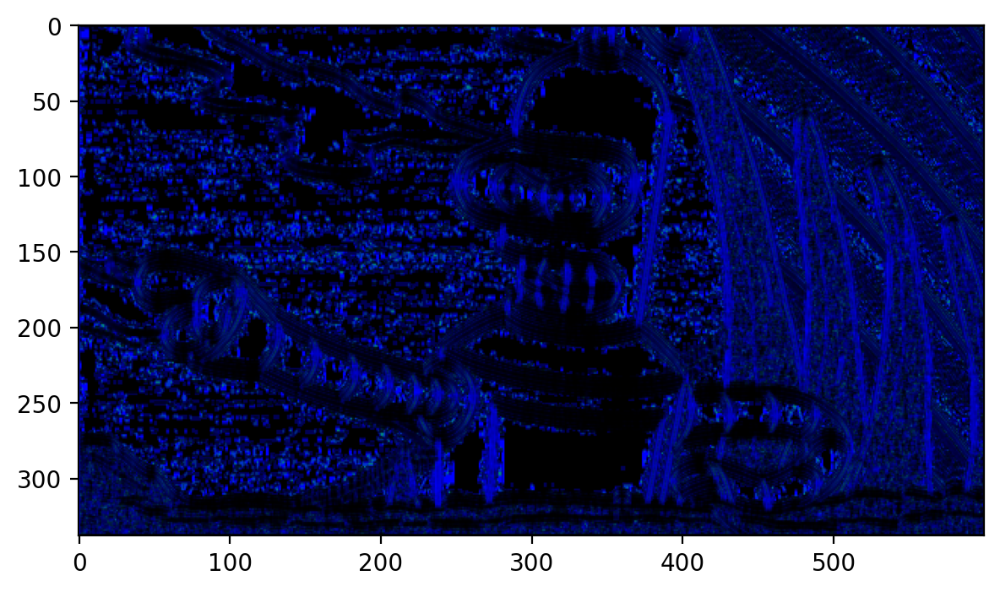

In [ ]:
from numpy.linalg import eig 


def top_eigenvalues(local_patch):
  normalized_lp = (local_patch  - local_patch.min())/(local_patch.max() - local_patch.min())
  covar_matrix = np.cov(normalized_lp)
  eigen_vals, eigen_vect = eig(np.nan_to_num(covar_matrix))
  return np.sort(eigen_vals)[0:3]


def eigen_filter(input_image, patch_size, agg_function):
  h, w = input_image.shape
  h_c, w_c = patch_size

  d_h = h_c // 2
  d_w = w_c // 2

  # apply zero-padding for the input image
  oper_image = np.zeros((h + 2 * d_h, w + 2 * d_w))
  oper_image[d_h:(h + d_h), d_w:(w + d_w)] = input_image
  output_img = np.zeros((h, w, 3))

  for i in range(h):
    for j in range(w):
      l_i = i + d_h
      l_j = j + d_w
      patch = oper_image[(l_i - d_h):(l_i + d_h + 1), (l_j - d_w):(l_j + d_w + 1)]
      output_img[i, j, :] = agg_function(patch)

  output_img = (output_img  - output_img.min())/(output_img.max() - output_img.min())
  return output_img


plt.imshow(eigen_filter(bender_img_gray, (3, 3), top_eigenvalues))

**References**

* [About eigenvectors and eigenvalues](https://wiki.pathmind.com/eigenvector)

* [Covariance matrix](https://datascienceplus.com/understanding-the-covariance-matrix/)

* [numpy eigenvalues decomposition](https://numpy.org/doc/stable/reference/generated/numpy.linalg.eig.html)